In [1]:
#import all the libraries we might need
import MEArec as mr
import numpy as np
import matplotlib.pylab as plt
import spikeinterface.extractors as se
import spikeinterface.sorters as ss
import spikeinterface.widgets as sw
import spikeinterface.comparison as sc
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import spikeinterface.full as si
import math
from scipy import stats
from scipy.signal import find_peaks
from operator import itemgetter
%matplotlib inline
import matplotlib.colors as mcolors
import random;
import json
from scipy.io import savemat
import scipy.signal
import os;
from scipy import signal;

In [2]:
#load the recording 
recording_file_name = "10Neuron5SecondRecordingWithNoise.h5"
recording_file_name = "10Neuron5SecondRecordingWithLevel2Noise.h5"
recording, sorting = se.read_mearec(recording_file_name);
recgen = mr.load_recordings(recording_file_name)

In [3]:
recording

MEArecRecordingExtractor: 384 channels - 30.0kHz - 1 segments - 150,150 samples - 5.00s 
                          float32 dtype - 219.95 MiB
  file_path: /home/mint/Desktop/10Neuron5SecondRecordingWithLevel2Noise.h5

In [4]:
sorting

MEArecSortingExtractor: 10 units - 1 segments - 30.0kHz
  file_path: /home/mint/Desktop/10Neuron5SecondRecordingWithLevel2Noise.h5

/home/mint/spike_gen/lib/python3.12/site-packages/spikeinterface/core/job_tools.py:103: UserWarning: `n_jobs` is not set so parallel processing is disabled! To speed up computations, it is recommended to set n_jobs either globally (with the `spikeinterface.set_global_job_kwargs()` function) or locally (with the `n_jobs` argument). Use `spikeinterface.set_global_job_kwargs?` for more information about job_kwargs.
  warnings.warn(


estimate_sparsity:   0%|          | 0/5 [00:00<?, ?it/s]

compute_waveforms:   0%|          | 0/5 [00:00<?, ?it/s]

/home/mint/spike_gen/lib/python3.12/site-packages/spikeinterface/core/job_tools.py:103: UserWarning: `n_jobs` is not set so parallel processing is disabled! To speed up computations, it is recommended to set n_jobs either globally (with the `spikeinterface.set_global_job_kwargs()` function) or locally (with the `n_jobs` argument). Use `spikeinterface.set_global_job_kwargs?` for more information about job_kwargs.
  warnings.warn(


Compute : spike_amplitudes + spike_locations:   0%|          | 0/5 [00:00<?, ?it/s]

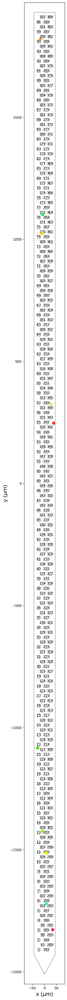

In [5]:
analyzer = si.create_sorting_analyzer(sorting=sorting,recording=recording,format="memory")
analyzer.compute(["random_spikes","waveforms","templates","noise_levels"])
analyzer.compute(["spike_amplitudes","unit_locations","spike_locations","template_metrics"])
sw.plot_unit_locations(analyzer, figsize=(50,50),with_channel_ids=True)
plt.savefig("Current Neuron Location Probe Map.png")

In [6]:
def create_artificial_tetrode(n_chan_per_tetr):
    #each probe has 384 channels
    #therefore: 
        # of artificial tetrodes = 384/n_chan_per_tetr
    #if: 
        # 384 % n_chan_per_tetr !=0 then the last artificial tetrode will be shorte
    #the goal of this function should be to return an array
    #where each row of the array represents an artificial tetrode
    #and each column represents a channel in that artifical tetrode
    
    n_chan_per_first_col = math.floor(n_chan_per_tetr / 2);
    n_chan_per_second_col = math.ceil(n_chan_per_tetr / 2);
    n_chan_per_third_col = n_chan_per_first_col;
    n_chan_per_fourth_col=n_chan_per_second_col;
    
    number_of_artificial_tetrodes = math.ceil(384 / n_chan_per_tetr)
    
    first_col_ptr = 1;
    second_col_ptr = 97;
    third_col_ptr = 193;
    fourth_col_ptr = 289;
    
    art_tetr_array =np.zeros((number_of_artificial_tetrodes,n_chan_per_tetr))
    for i in range(0,number_of_artificial_tetrodes,2):
        #create the first artifical tetrode 
        #tetrodes are built in such a way that the channels closest to each other are picked
        #for this reason I build them by taking n_chan_per_first_col from the first column 
        #and n_chan_per_second_col from the second_col
        #n_chan_per_second_col + n_chan_per_first_col = n_chan_per_tetr
        #similarly
        #n_chan_per_third_col + n_chan_per_fourth_colo = n_chan_per_tetr
        #tetrodes are built from the bottom left -> right
        #for example if the n_chan_per_tetr = 4
        #then the first tetrode will be composed of chanels 1,2,97,98
        #the second will be composed of channels 193,194,289,290
        #there is no channel 0, so any values with that number should be filtered out later

        for k in range(0,n_chan_per_first_col,1):
            art_tetr_array[i][k] = first_col_ptr;
            first_col_ptr = first_col_ptr+1;
            
        for p in range(n_chan_per_first_col,n_chan_per_tetr,1):
            art_tetr_array[i][p] = second_col_ptr;
            second_col_ptr = second_col_ptr+1;

        
        for k in range(0,n_chan_per_third_col,1):
            art_tetr_array[i+1][k] = third_col_ptr;
            third_col_ptr = third_col_ptr+1;
        for p in range(n_chan_per_third_col,n_chan_per_tetr,1):
            art_tetr_array[i+1][p] = fourth_col_ptr
            fourth_col_ptr = fourth_col_ptr+1;

    return art_tetr_array;
    

In [7]:
def plot_n_channels(rec_gen_object,channels,single_plot_or_not,tetrode_number):
    time_stamps = rec_gen_object.timestamps[:]
    if single_plot_or_not:
        fig, ax = plt.subplots(len(channels),figsize=(40,40))
        for i in range(len(channels)):
            voltage_readings = rec_gen_object.recordings[:,int(channels[i]-1)]
            #print(rec_gen_object.timestamps.size)
            #print(rec_gen_object.recordings[:,channels[i]].size)
            ax[i].plot(time_stamps,voltage_readings)
            ax[i].set_xlabel("Time in seconds")
            ax[i].set_ylabel("Voltage")
            #ax[i].set_ylim(y_limits)
            ax[i].set_title("Channel "+ str(channels[i]))
            
        plt.show()
        
    else:
        fig, ax = plt.subplots()
        for i in range(len(channels)):
            plt.plot(time_stamps,rec_gen_object.recordings[:,int(channels[i]-1)],label="Channel "+str(int(channels[i])))
        plt.xlabel("Time in seconds")
        plt.ylabel("Voltage")
        plt.title("Tetrode Number " +str(tetrode_number+1))
        plt.legend()
        plt.show()
    #fig.savefig(figure_file_name_save)
    

In [8]:
def plot_n_channels_ver_2(time_stamps,recordings,channels,single_plot_or_not,tetrode_number):
    
    if single_plot_or_not:
        fig, ax = plt.subplots(len(channels),figsize=(40,40))
        for i in range(len(channels)):
            voltage_readings = recordings[:,int(channels[i]-1)]
            #print(rec_gen_object.timestamps.size)
            #print(rec_gen_object.recordings[:,channels[i]].size)
            ax[i].plot(time_stamps,voltage_readings)
            ax[i].set_xlabel("Time in seconds")
            ax[i].set_ylabel("Voltage")
            #ax[i].set_ylim(y_limits)
            ax[i].set_title("Channel "+ str(channels[i]))
            
        plt.show()
        
    else:
        fig, ax = plt.subplots()
        for i in range(len(channels)):
            plt.plot(time_stamps,recordings[:,int(channels[i]-1)],label="Channel "+str(int(channels[i])))
        plt.xlabel("Time in seconds")
        plt.ylabel("Voltage")
        plt.title("Tetrode Number " +str(tetrode_number+1))
        plt.legend()
        plt.show()

In [9]:
def calculate_the_mean_per_chan(recording_matrix):
    channel_wise_mean = np.mean(recording_matrix[:],axis=0);
    return channel_wise_mean;

In [10]:
def calculate_the_standard_deviation_per_chan(recording_matrix):
    channel_wise_standard_deviation = np.std(recording_matrix[:],axis=0);
    return channel_wise_standard_deviation;

In [11]:
def calculate_the_z_score_for_every_y(recording_matrix):
    z_scores = stats.zscore(recording_matrix[:],0);
    return z_scores

In [125]:
def get_spike_windows(z_score_matrix,spikes_per_channel,desired_z_score,desired_number_of_data_points):
    spike_windows = [[]];
    for i in range(0,len(spikes_per_channel),1):
        spike_windows.append([])
        for j in range(0,len(spikes_per_channel[i]),1):
            channel_i_peak_j = spikes_per_channel[i][j];
            channel_i_peak_j_z_score = z_score_matrix[i][j];
            if channel_i_peak_j < desired_number_of_data_points//2:
                continue
            else:
                #if abs(channel_i_peak_j_z_score) >= desired_z_score:
                spike_windows[i].append(tuple((spikes_per_channel[i][j]-desired_number_of_data_points//2,spikes_per_channel[i][j]+desired_number_of_data_points//2,i+1,channel_i_peak_j)))
                    #each tupple is made up of 4 numbers:
                        #the first is the beginning of the spike window
                        #the second is the end of the spike_window
                        #the third is the original channel of the spike
                        #the fourth is the original the peak of the spike according to find_peaks
    return spike_windows

In [77]:
def detect_spikes(recording_matrix,widths):
    spikes_matrix = []
    for i in range(0,len(recording_matrix[0]),1):
        peaks, _= find_peaks(recording_matrix[:,i],height=0)
        spikes_matrix.append(peaks);
    return spikes_matrix

In [14]:
def detect_spikes_ver_2(recording_matrix,hertz,sample_rate,order_of_filter):
    spikes_matrix = []
    filtered_recording_matrix = np.zeros((recording_matrix[:,1].size,1));
    for i in range(0,len(recording_matrix[0]),1):
        filtered_data = run_high_pass_filter(recording_matrix[:,i],hertz,sample_rate,order_of_filter)
        peaks, _ = find_peaks(filtered_data, height=0)
        spikes_matrix.append(peaks);
        if i==0:
            filtered_recording_matrix[:,i] = filtered_data;
        else:
            #print(filtered_recording_matrix.size)
            #print(filtered_data.size)
            filtered_recording_matrix = np.hstack((filtered_recording_matrix,filtered_data.reshape(len(filtered_data),1)));
    return spikes_matrix,filtered_recording_matrix;

In [15]:
def run_high_pass_filter(channel_recording,hertz_cutoff,sample_rate,order_of_filter):
    sos = scipy.signal.butter(order_of_filter,hertz_cutoff,'highpass',fs=sample_rate,output='sos');
    filtered_data = scipy.signal.sosfiltfilt(sos,channel_recording);
    return filtered_data;

In [16]:
def get_slices_per_artificial_tetrode(chan_of_art_tetr,spike_windows,recording_matrix,timing_matrix):
    spike_slices = [[]];
    time_slices = [[]]
    for curr_chan in chan_of_art_tetr: #this for loop takes cycles through all channels in the current artificial tetrode
        i=0;
        spike_slices.append([]);
        time_slices.append([]);
        for curr_spike in spike_windows[int(curr_chan)]:
            if len(curr_spike)==0:
                continue;
            slices_from_all_n_tetrodes = [];
            time_slices_for_curr_spike = [timing_matrix[curr_spike[0]:curr_spike[1]]];
            for curr_chan_2 in chan_of_art_tetr:   #this for loop takes a slice from all n channels in the tetrode for the current channel's spike
                slices_from_all_n_tetrodes.append(recording_matrix[int(curr_chan_2)][curr_spike[0]:curr_spike[1]])
                
            spike_slices[i].append(slices_from_all_n_tetrodes);
            time_slices[i].append(time_slices_for_curr_spike);
        i = i+1;

    return spike_slices,time_slices


In [17]:
def flatten_spike_windows_and_sort(spike_windows):
    flattend_spike_windows = [];
    original_channel_and_index = [];
    for current_channel in spike_windows:
        for current_spike_window in current_channel:
            #print(current_spike_window)
            flattend_spike_windows.append(current_spike_window);
    flattend_spike_windows.sort()
    return flattend_spike_windows

In [ ]:
def get_slices_per_artificial_tetrode_ver_2(chan_of_art_tetr,spike_windows,recording_matrix,timing_matrix):
    spike_slices = [];
    time_slices = [];
    spiking_channels = [];
    #get the spike windows for all channels in the current tetrode
    spike_windows_for_current_tetrode = [];
    for current_chan in chan_of_art_tetr:
        spike_windows_for_current_tetrode.append(spike_windows[int(current_chan)-1])
    #print(spike_windows_for_current_tetrode)
    #print("/////////////////////////////////")
    flattened_and_sorted_spike_windows = flatten_spike_windows_and_sort(spike_windows_for_current_tetrode); # get flattened and sorted spike windows
    #print(flattened_and_sorted_spike_windows)
    for current_window in flattened_and_sorted_spike_windows:
        #print(current_window)
        window_beginning = int(current_window[0]);
        window_end =int( current_window[1]);
        current_window_across_all_channels = np.zeros((window_end-window_beginning,1));
        current_timing_slice = timing_matrix[window_beginning:window_end];
        time_slices.append(current_timing_slice.tolist());
        channel_counter = 0;
        for current_chan in chan_of_art_tetr:
            current_chan_data = recording_matrix[:,int(current_chan)-1];
            current_chan_slice = current_chan_data[window_beginning:window_end];
            #print(current_window_across_all_channels)
            #print(current_chan_slice)
            if channel_counter==0:
                #print(current_window_across_all_channels.shape)
                #print(current_chan_slice.shape)
                if len(current_chan_slice) != len(current_window_across_all_channels):
                    break;
                current_window_across_all_channels[:,channel_counter] = current_chan_slice;
            else:
                current_window_across_all_channels = np.hstack((current_window_across_all_channels,current_chan_slice.reshape((window_end-window_beginning,1))))
            channel_counter = channel_counter+1;
        spike_slices.append(current_window_across_all_channels.tolist())
        spiking_channels.append(current_window[2])
    return spike_slices, time_slices, spiking_channels;
    

In [19]:
def get_list_of_css_colors(number_of_colors_needed):
    different_colors_to_use = [];
    css_colors_dict = mcolors.CSS4_COLORS
    for key in css_colors_dict:
        different_colors_to_use.append(str(css_colors_dict[key]))
    return different_colors_to_use;

In [20]:
def plot_the_spikes_of_the_tetrode(channel_you_want_plotted,tetrode_dictionary,spike_tetrode_dictionary,timing_tetrode_dictionary,channel_to_tetrode_dictionary,rec_gen_object):
    which_tetrode_your_channel_exists_in = channel_to_tetrode_dictionary[channel_you_want_plotted];
    
    spikes_for_current_tetrode = spike_tetrode_dictionary[which_tetrode_your_channel_exists_in];
    timing_for_current_tetrode = timing_tetrode_dictionary[which_tetrode_your_channel_exists_in];
    
    channels = tetrode_dictionary[which_tetrode_your_channel_exists_in];
    number_of_channels_in_your_tetrode = len(channels);
    
    spike_counter = 0;
    time_stamps = rec_gen_object.timestamps[:]
    fig, axs = plt.subplots(number_of_channels_in_your_tetrode,1,layout='constrained')
    
    for i in range(0,number_of_channels_in_your_tetrode,1):
        axs[i].plot(time_stamps,rec_gen_object.recordings[:,int(channels[i]-1)],label="Channel "+str(int(channels[i]))) # plots the entire channel activity
        axs[i].set_title("Channel " + str(channels[i]))
    #now plot the spikes ontop of the original channel in a differnet color
    different_colors_to_use = get_list_of_css_colors(10);
    for i in range(0,number_of_channels_in_your_tetrode,1):
        current_channel = int(channels[i]);
        for j in range(0,len(timing_for_current_tetrode),1):
            current_timings_aka_x_values = timing_for_current_tetrode[j];
            current_spike_aka_y_values = spikes_for_current_tetrode[0][:,i];
            axs[i].plot(current_timings_aka_x_values,current_spike_aka_y_values,c=different_colors_to_use[j]);
            axs[i].legend()
    fig.suptitle("Tetrode # " +str(which_tetrode_your_channel_exists_in))
   

In [21]:
def plot_the_spikes_of_the_tetrode_ver_2(channel_you_want_plotted,tetrode_dictionary,spike_tetrode_dictionary,timing_tetrode_dictionary,channel_to_tetrode_dictionary,spiking_channel_tetrode_dictionary,save_name,save_dir):
    which_tetrode_your_channel_exists_in = channel_to_tetrode_dictionary[channel_you_want_plotted];
    
    spikes_for_current_tetrode = spike_tetrode_dictionary[which_tetrode_your_channel_exists_in] #nx1 list where each n is a slice of the recorded times from all current channels in the tetrode;
    number_of_spikes_in_tetrode = len(spikes_for_current_tetrode);
    timing_for_current_tetrode = timing_tetrode_dictionary[which_tetrode_your_channel_exists_in]; #gets all timing associated with the slice
    which_channels_are_spiking_for_current_tetrode = spiking_channel_tetrode_dictionary[which_tetrode_your_channel_exists_in] #a dictionary where the value is a list of which channel the spike n was detected for 
    channels = tetrode_dictionary[which_tetrode_your_channel_exists_in];
    number_of_channels_in_your_tetrode = len(channels);
    
    #fig, axs = plt.subplots(number_of_spikes_in_tetrode,1,layout='constrained')
    
    
    different_colors_to_use = get_list_of_css_colors(10);
    for i in range(0,number_of_spikes_in_tetrode,1):
        fig = plt.figure()
        current_timings_aka_x_values = timing_for_current_tetrode[i]; #gets timings for the current spikes
        current_tetrode_y_values = spikes_for_current_tetrode[i]; #gets the y-values for the current spike
                                                                    #this variable is a px40 2d array where each column is the data points of a channel 
        current_tetrode_y_values = np.array(current_tetrode_y_values);
        number_of_channels_in_current_tetrode = len(channels)
        current_spiking_channel = which_channels_are_spiking_for_current_tetrode[i];
        for j in range(0,number_of_channels_in_current_tetrode,1):
            #print(current_tetrode_y_values)
            current_channel_spike_value_aka_y_values = current_tetrode_y_values[:,j];
            if channels[j] != current_spiking_channel:
                line_label = "Channel "+str(channels[j]);
            else:
                line_label = "Channel " + str(channels[j]) + " (Spiking)";
            plt.plot(current_timings_aka_x_values,current_channel_spike_value_aka_y_values,label=line_label)
            if channels[j] == current_spiking_channel:
                spiking_channel_x_of_peak = current_timings_aka_x_values[20];
                spiking_channel_y_of_peak = current_channel_spike_value_aka_y_values[20];
                
        plt.plot(spiking_channel_x_of_peak,spiking_channel_y_of_peak,marker="o",markersize=10,markerfacecolor="red",label="Peak of channel " +str(int(current_spiking_channel)) + " ("+ str(round(spiking_channel_x_of_peak,2))+","+str(round(spiking_channel_y_of_peak,2))+")");
        
        plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
        plt.title("Spike #" + str(i+1))
        plt.savefig(save_dir+"/"+"Tetrode " +str(which_tetrode_your_channel_exists_in)+ "Spike "+ str(i+1)+ "Channel " + str(current_spiking_channel)+ save_name)
        plt.show();   
        #fig.suptitle("Tetrode # " +str(which_tetrode_your_channel_exists_in));
    #plt.show;
    #plt.savefig(save_name,dpi=100)

In [178]:
def create_a_file_if_it_doesnt_exist_and_return_path(dir_to_save_figs_to):
    cwd = os.getcwd();
    path = os.path.join(cwd,dir_to_save_figs_to);
    try:
        os.mkdir(path);
    except OSError as error:
        print(error);
    #return dir_to_save_figs_to;

In [191]:
def plot_the_spikes_of_the_tetrode_ver_3(channel_you_want_plotted,tetrode_dictionary,spike_tetrode_dictionary,timing_tetrode_dictionary,channel_to_tetrode_dictionary,spiking_channel_tetrode_dictionary,save_name,save_dir,number_of_data_points_in_window):
    #print("Makes It inside the function")
    create_a_file_if_it_doesnt_exist_and_return_path(save_dir);
    which_tetrode_your_channel_exists_in = channel_to_tetrode_dictionary[channel_you_want_plotted];
    
    spikes_for_current_tetrode = spike_tetrode_dictionary[which_tetrode_your_channel_exists_in] #nx1 list where each n is a slice of the recorded times from all current channels in the tetrode;
    number_of_spikes_in_tetrode = len(spikes_for_current_tetrode);
    timing_for_current_tetrode = timing_tetrode_dictionary[which_tetrode_your_channel_exists_in]; #gets all timing associated with the slice
    which_channels_are_spiking_for_current_tetrode = spiking_channel_tetrode_dictionary[which_tetrode_your_channel_exists_in] #a dictionary where the value is a list of which channel the spike n was detected for 
    channels = tetrode_dictionary[which_tetrode_your_channel_exists_in];
    
    
    #fig, axs = plt.subplots(number_of_spikes_in_tetrode,1,layout='constrained')
    
    
    different_colors_to_use = get_list_of_css_colors(10);
    for i in range(0,number_of_spikes_in_tetrode,1):
        #print(i)
        number_of_channels_in_current_tetrode = len(channels);
        
        current_timings_aka_x_values = timing_for_current_tetrode[i]; #gets timings for the current spikes
        current_tetrode_y_values = spikes_for_current_tetrode[i]; #gets the y-values for the current spike
                                                                    #this variable is a px40 2d array where each column is the data points of a channel 
        current_tetrode_y_values = np.array(current_tetrode_y_values);
        
        current_spiking_channel = which_channels_are_spiking_for_current_tetrode[i];
        for j in range(0,number_of_channels_in_current_tetrode,1):
            #print(current_tetrode_y_values)
            current_channel_spike_value_aka_y_values = current_tetrode_y_values[:,j];
            current_channel_spike_value_aka_y_values = current_channel_spike_value_aka_y_values *-1;
            plt.subplot(1,number_of_channels_in_current_tetrode,j+1);
            plt.plot(current_timings_aka_x_values,current_channel_spike_value_aka_y_values)
            if channels[j] != current_spiking_channel:
                plt.title(str(int(channels[j])))
            else:
                plt.title(str(int(channels[j]))+"(Spiking)");
            
            #plt.legend()
            if channels[j] == current_spiking_channel:
                spiking_channel_x_of_peak = current_timings_aka_x_values[number_of_data_points_in_window//2];
                spiking_channel_y_of_peak = current_channel_spike_value_aka_y_values[number_of_data_points_in_window//2];
                
        #plt.plot(spiking_channel_x_of_peak,spiking_channel_y_of_peak,marker="o",markersize=10,markerfacecolor="red",label="Peak of channel " +str(int(current_spiking_channel)) + " ("+ str(round(spiking_channel_x_of_peak,2))+","+str(round(spiking_channel_y_of_peak,2))+")");
        
        
        plt.suptitle("Spike #" + str(i+1))
        plt.savefig(save_dir+"/"+"Tetrode " +str(which_tetrode_your_channel_exists_in)+ "Spike "+ str(i+1)+ "Channel " + str(current_spiking_channel)+ save_name)
        plt.show();   
        #fig.suptitle("Tetrode # " +str(which_tetrode_your_channel_exists_in));
    #plt.show;
    #plt.savefig(save_name,dpi=100)

In [209]:
def save_all_the_dictionaries_to_json_files(list_of_dictionaries,list_of_names):
    #print(list_of_dictionaries)
    name_counter = 0;
    print(len(list_of_dictionaries))
    for current_dict in list_of_dictionaries:
        matlab_compatible_dict = {};
        for key in current_dict:
            if isinstance(current_dict[key],np.ndarray):
                matlab_compatible_dict["c"+str(int(key))] = current_dict[key].tolist();
            else:
                matlab_compatible_dict["c"+str(int(key))] = current_dict[key];
                #print(type(matlab_compatible_dict["c"+str(key)]))
            #savemat(list_of_names[name_counter],matlab_compatible_dict)
        print(list_of_names[name_counter])
        with open(list_of_names[name_counter],"w") as outfile:
            json.dump(matlab_compatible_dict,outfile)
        name_counter = name_counter+1;
            

In [70]:
def zero_out_values_that_dont_meet_min_z_score(recording_matrix,z_score_matrix,min_z_score):
    zeroed_out_recording = np.zeros((len(recording_matrix),len(recording_matrix[0])));
    for i in range(0,len(recording_matrix[0]),1):
        current_vector_of_y_points = recording_matrix[:,i];
        current_vector_of_z_scores = z_score_matrix[:,i];
        for j in range(0,len(current_vector_of_y_points),1):
            current_value = current_vector_of_y_points[j];
            current_z_score = current_vector_of_z_scores[j];
            if abs(current_z_score) >= min_z_score:
                zeroed_out_recording[j][i] = current_value; 
    return zeroed_out_recording;

In [25]:
def remove_average_from_all_channels(recording_matrix):
    mean_of_recording = np.mean(recording_matrix);
    recording_matrix -= mean_of_recording;
    return recording_matrix

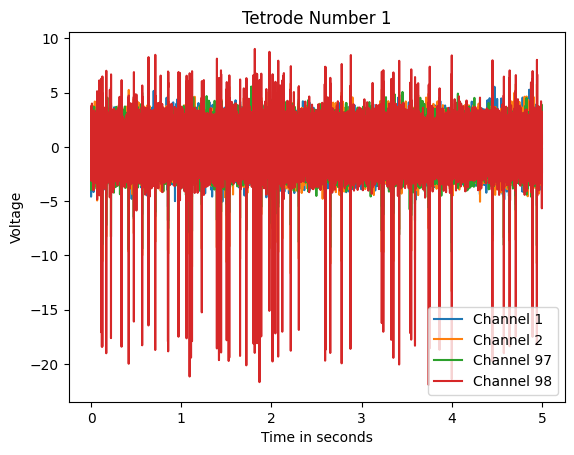

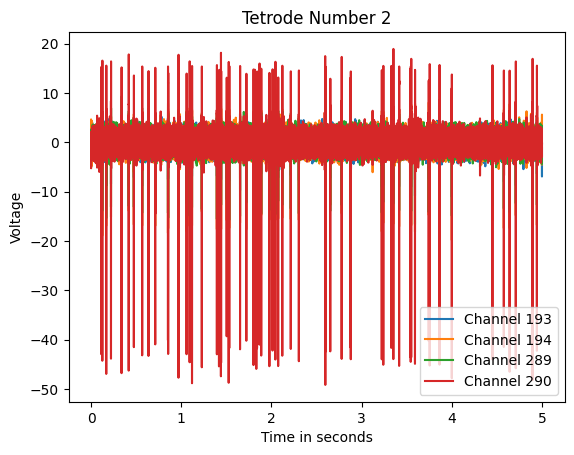

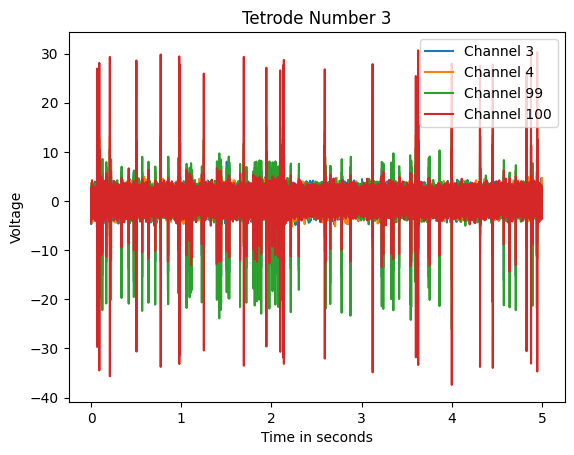

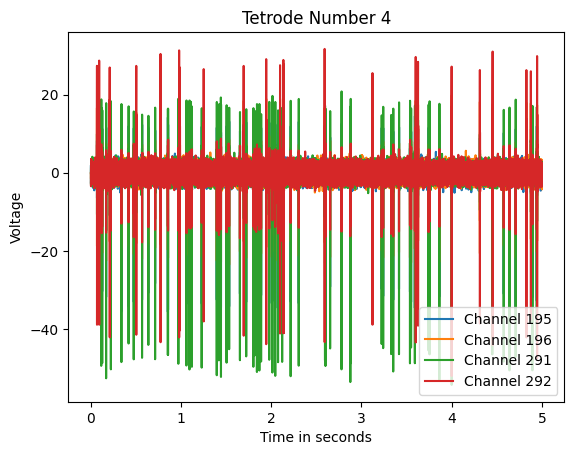

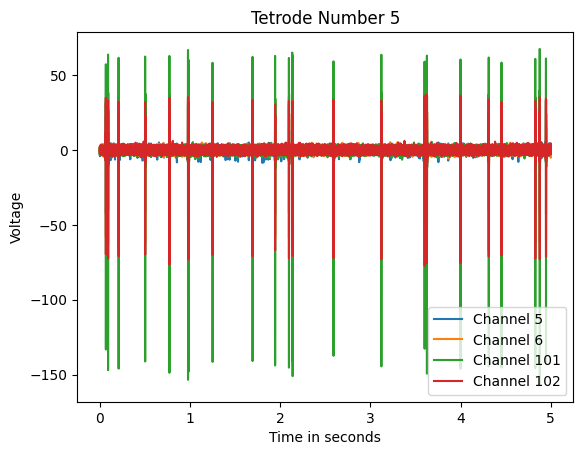

...

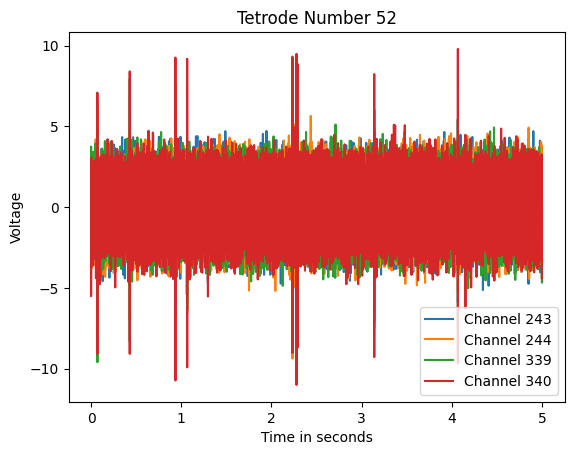

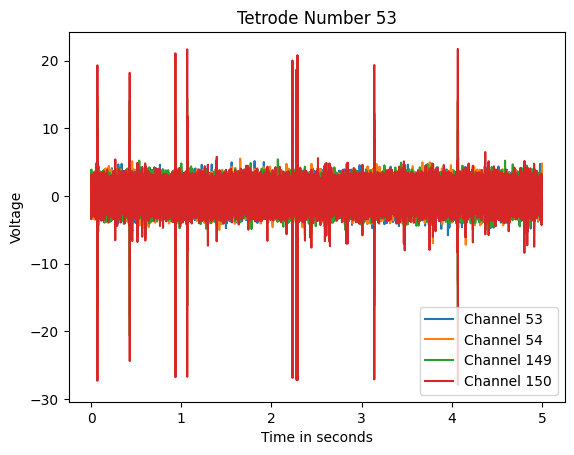

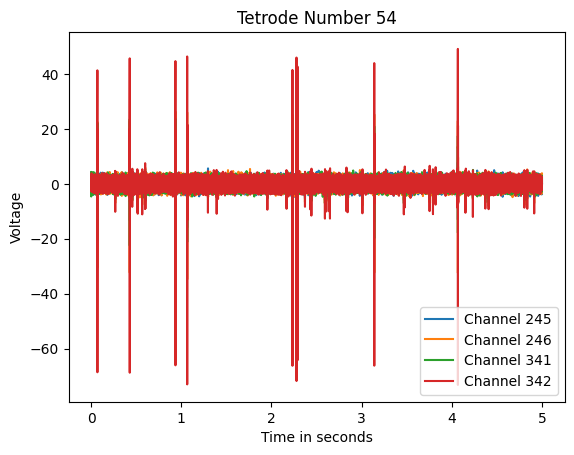

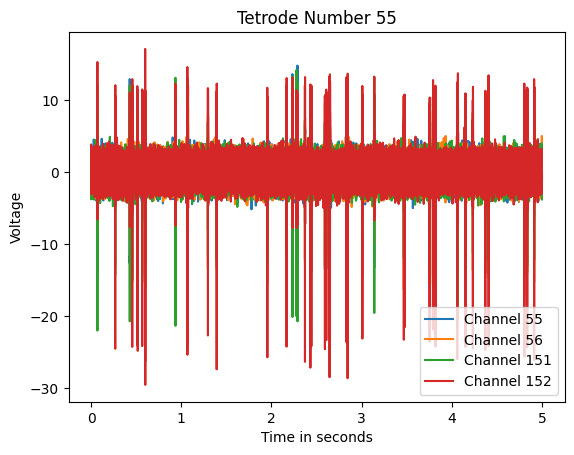

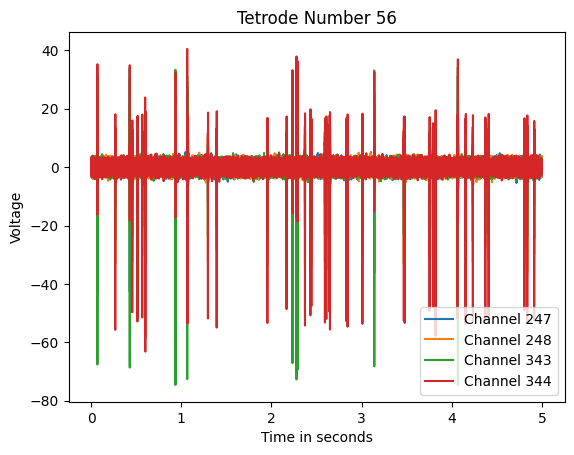

KeyboardInterrupt: 

In [182]:
for k in range(0,len(artificial_tetrode_array),1):
    current_tetrode = artificial_tetrode_array[k][:]
    plot_n_channels(recgen,current_tetrode,False,k)

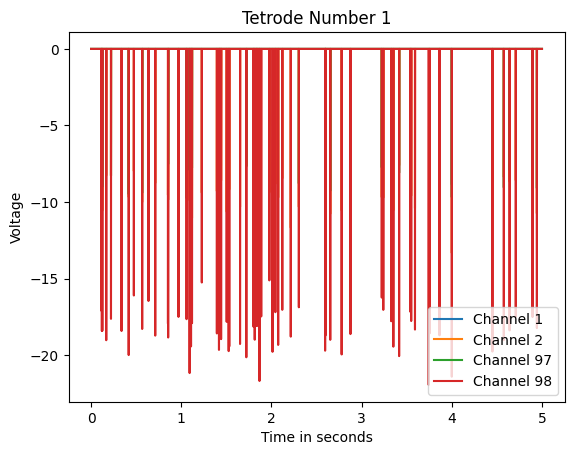

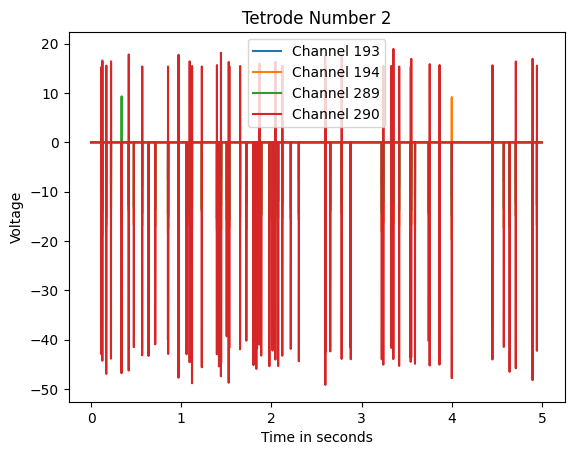

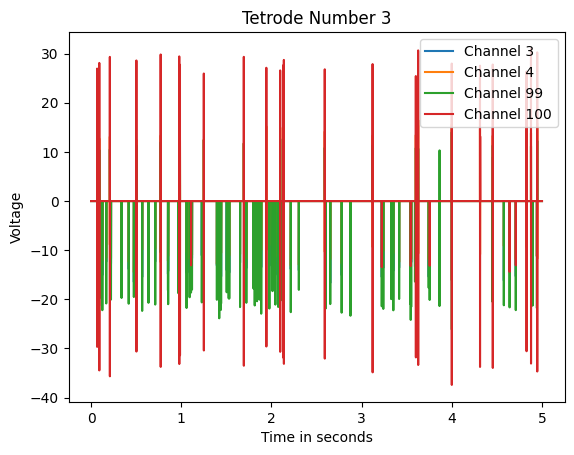

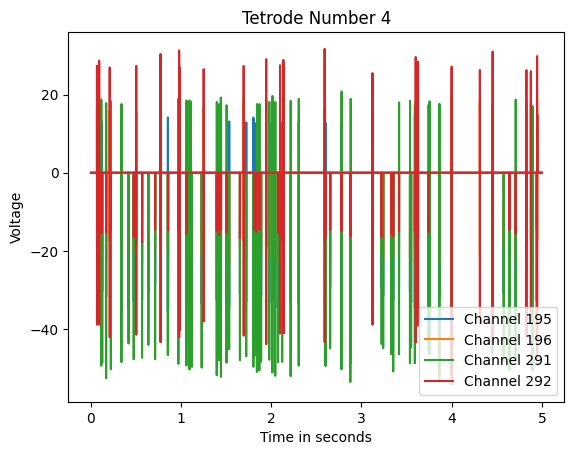

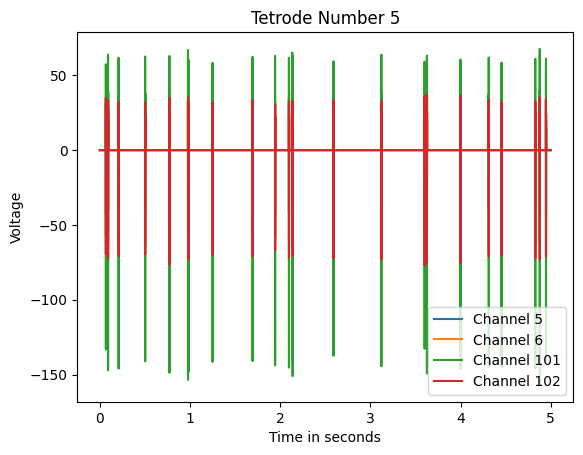

...

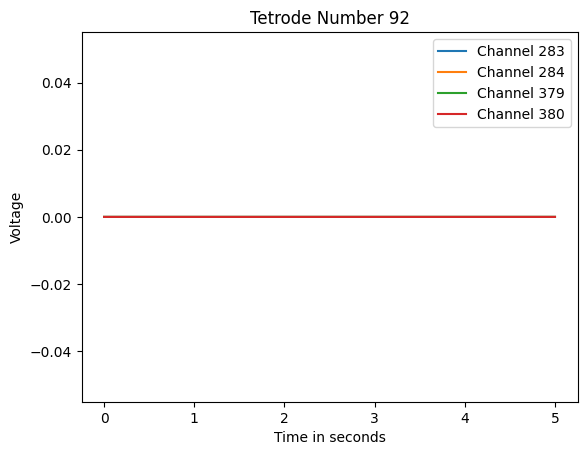

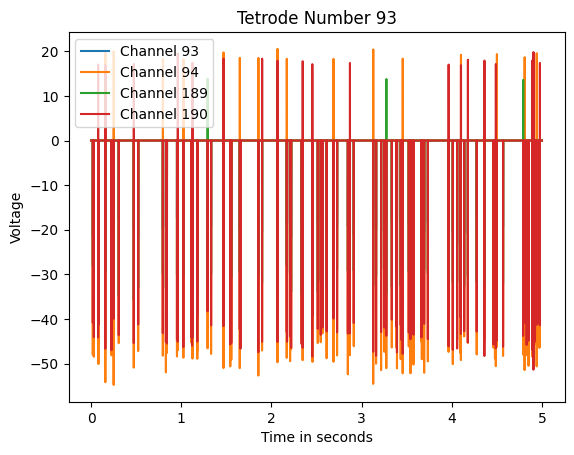

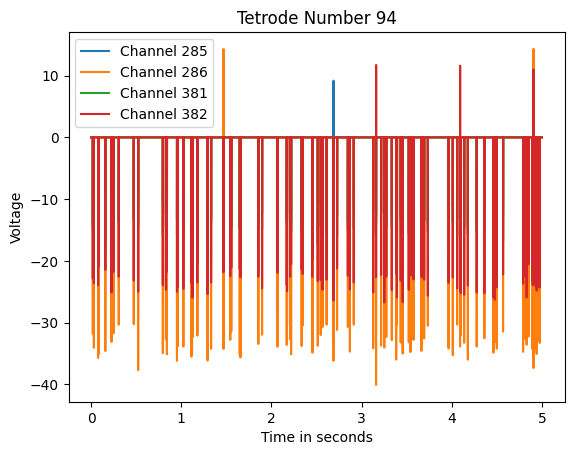

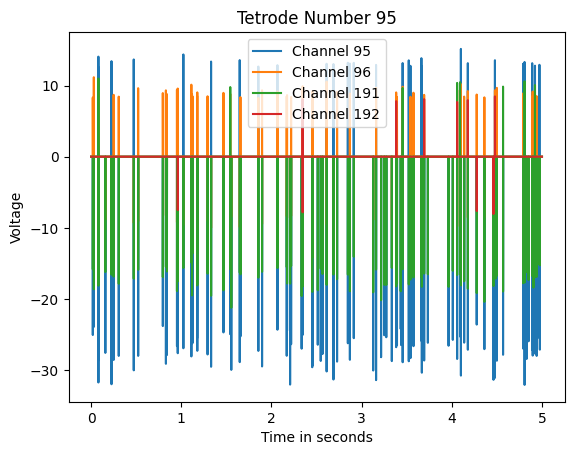

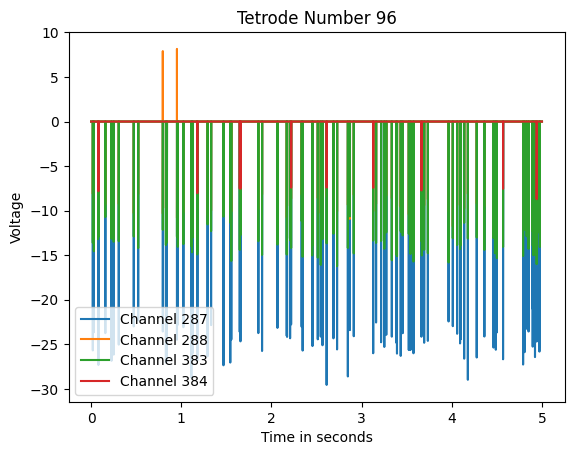

In [183]:
for k in range(0,len(artificial_tetrode_array),1):
    current_tetrode = artificial_tetrode_array[k][:]
    plot_n_channels_ver_2(recgen.timestamps[:],rm_with_mean_removed_and_min_z_score_filter,current_tetrode,False,k)



In [377]:
recording_matrix_with_mean_removed[:,1]

array([-0.07241691, -1.5645825 , -1.6656426 , ..., -3.5666487 ,
       -2.522543  , -0.20748584], dtype=float32)

In [35]:
chan_std_dvns = calculate_the_standard_deviation_per_chan(recgen.recordings)
chan_means = calculate_the_mean_per_chan(recgen.recordings)
chan_z_scores = calculate_the_z_score_for_every_y(recgen.recordings)
#chan_z_scores = chan_z_scores.transpose()

In [68]:
len(recording_matrix_with_mean_removed[0])

384

In [73]:
rm_with_mean_removed_and_min_z_score_filter.shape

(150150, 384)

In [78]:
hertz = 350;
sample_rate = 30000;
order_of_filter = 10;


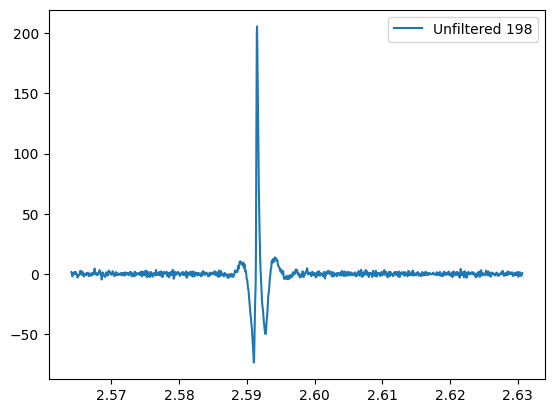

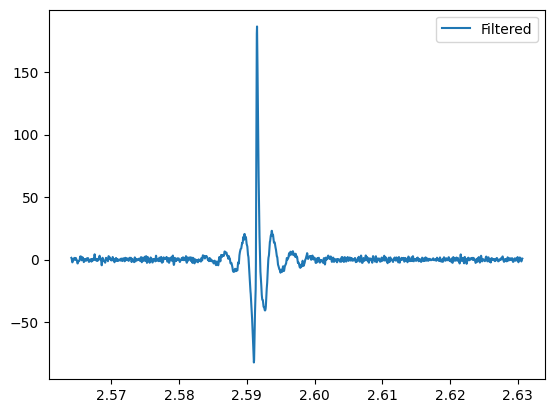

In [323]:
left = 77000
right = 79000
x_points = a[left:right]
#y_points = recgen.recordings[left:right,196] * -1;
#plt.plot(x_points,y_points,label="Unfiltered 197")
y_points = recgen.recordings[left:right,197] * -1;
plt.plot(x_points,y_points,label="Unfiltered 198")
#y_points = recgen.recordings[left:right,292] *-1;
#plt.plot(x_points,y_points,label="Unfiltered 293")
#y_points = recgen.recordings[left:right,293] * -1;
#plt.plot(x_points,y_points,label="294")
plt.legend()
plt.show()

x_points = a[left:right]
y_points = np.array(filtered_recordings)[left:right,197] * -1;
plt.plot(x_points,y_points,label="Filtered")
plt.legend()
plt.show()

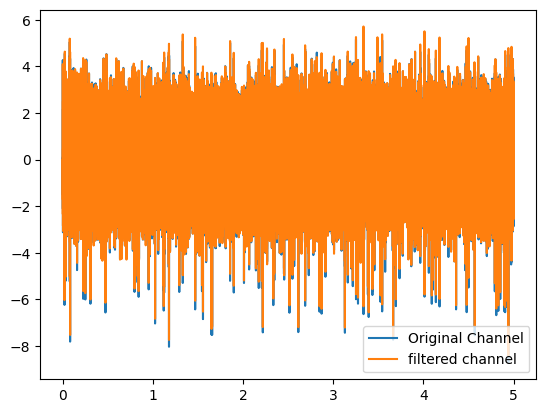

In [210]:
fig,ax = plt.subplots();
plt.plot(recgen.timestamps[:],recgen.recordings[:,383],label="Original Channel")
plt.plot(recgen.timestamps[:],filtered_recordings[:,383],label="filtered channel")
plt.legend()
plt.show()

In [200]:
chan_std_dvns = calculate_the_standard_deviation_per_chan(recgen.recordings)
chan_means = calculate_the_mean_per_chan(recgen.recordings)
chan_z_scores = calculate_the_z_score_for_every_y(recgen.recordings)


recording_matrix_with_mean_removed = remove_average_from_all_channels(recgen.recordings);
rm_with_mean_removed_and_min_z_score_filter = zero_out_values_that_dont_meet_min_z_score(recording_matrix_with_mean_removed,chan_z_scores,6);
spikes_per_channel = detect_spikes(rm_with_mean_removed_and_min_z_score_filter,1);


spike_windows = get_spike_windows(chan_z_scores,spikes_per_channel,3,200)
#spike windows is an nxp list
    #n: number of channels
    #p: number of spikes for channel n
#Each item in the list is a tupple
#ex) spike_windows[3][:] will return all spikes recorded in channel 4
#an empty list in spike windows means that channel had no spikes detected
#each tupple is made up of 4 numbers:
                        #the first is the beginning of the spike window
                        #the second is the end of the spike_window
                        #the third is the original channel of the spike
                        #the fourth is the original the peak of the spike according to find_peaks

In [201]:
print(spikes_per_channel[0])
print(spikes_per_channel[1])
print(spike_windows[0])
print(spike_windows[1])

[87099]
[  3511   3671   4404   5844   8388  11336  13386  15632  18068  20241
  23484  25637  27390  30450  32302  33047  33449  35240  39378  42241
  42637  42958  43267  44228  45489  45920  47814  50655  52893  54291
  54761  55146  55671  57728  60375  61839  62988  65083  67839  73561
  77968  78049  78871  81540  84904  86423  91634  97052  98634 100306
 101619 104406 106334 106517 107229 110303 114386 118068 126883 135545
 138403 140392 144212 147727]
[(86999, 87199, 1, 87099)]
[(3411, 3611, 2, 3511), (3571, 3771, 2, 3671), (4304, 4504, 2, 4404), (5744, 5944, 2, 5844), (8288, 8488, 2, 8388), (11236, 11436, 2, 11336), (13286, 13486, 2, 13386), (15532, 15732, 2, 15632), (17968, 18168, 2, 18068), (20141, 20341, 2, 20241), (23384, 23584, 2, 23484), (25537, 25737, 2, 25637), (27290, 27490, 2, 27390), (30350, 30550, 2, 30450), (32202, 32402, 2, 32302), (32947, 33147, 2, 33047), (33349, 33549, 2, 33449), (35140, 35340, 2, 35240), (39278, 39478, 2, 39378), (42141, 42341, 2, 42241), (42

In [202]:
slice_0,timing_0,spiking_channel_list = get_slices_per_artificial_tetrode_ver_2(artificial_tetrode_array[6],spike_windows,rm_with_mean_removed_and_min_z_score_filter,recgen.timestamps[:]);

In [203]:
slice_0

[[[0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0

In [204]:
tetrode_counter = 0;
tetrode_dictionary = {};
spike_tetrode_dictionary = {};
timing_tetrode_dictionary = {};
channel_to_tetrode_dictionary = {};
spiking_channel_tetrode_dictionary = {};
artificial_tetrode_array = create_artificial_tetrode(4)
for art_tetr in artificial_tetrode_array:
    tetrode_dictionary[tetrode_counter+1] = art_tetr;
    for current_channel in art_tetr:
        channel_to_tetrode_dictionary[current_channel] = tetrode_counter+1;
    slice_0,timing_0,spiking_channel_list =get_slices_per_artificial_tetrode_ver_2(art_tetr,spike_windows,recgen.recordings,recgen.timestamps[:]);
    spike_tetrode_dictionary[tetrode_counter+1] = slice_0;
    timing_tetrode_dictionary[tetrode_counter+1] = timing_0;
    spiking_channel_tetrode_dictionary[tetrode_counter+1] = spiking_channel_list;
    tetrode_counter=tetrode_counter+1;

In [210]:
list_of_dictionaries = [tetrode_dictionary,spike_tetrode_dictionary,timing_tetrode_dictionary,channel_to_tetrode_dictionary,spiking_channel_tetrode_dictionary];
list_of_names = ["tetrode_dictionary.json","spike_tetrode_dictionary.json","timing_tetrode_dictionary.json","channel_to_tetrode_dictionary.json","spiking_channel_tetrode_dictionary.json"];
save_all_the_dictionaries_to_json_files(list_of_dictionaries,list_of_names)


5
tetrode_dictionary.json
spike_tetrode_dictionary.json
timing_tetrode_dictionary.json
channel_to_tetrode_dictionary.json
spiking_channel_tetrode_dictionary.json


In [206]:
print(channel_to_tetrode_dictionary[198])
print(tetrode_dictionary[6])
print(len(spike_tetrode_dictionary[6]))

6
[197. 198. 293. 294.]
190


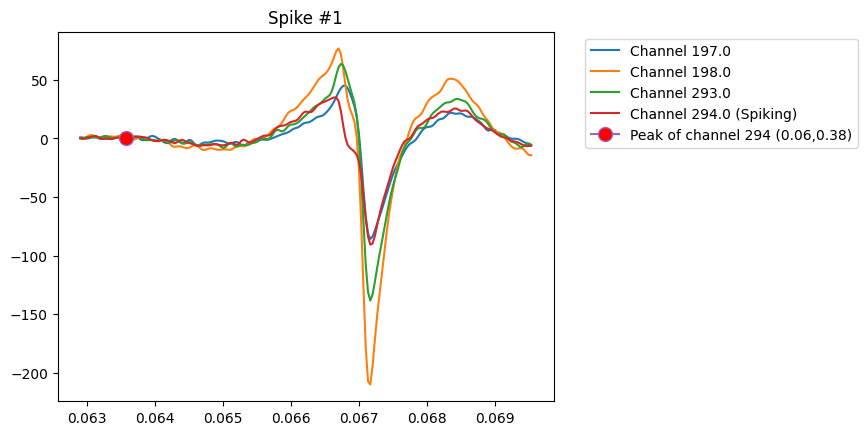

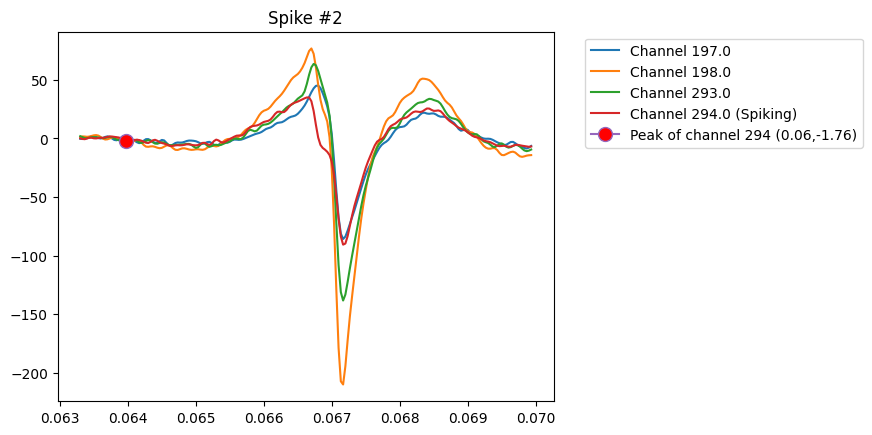

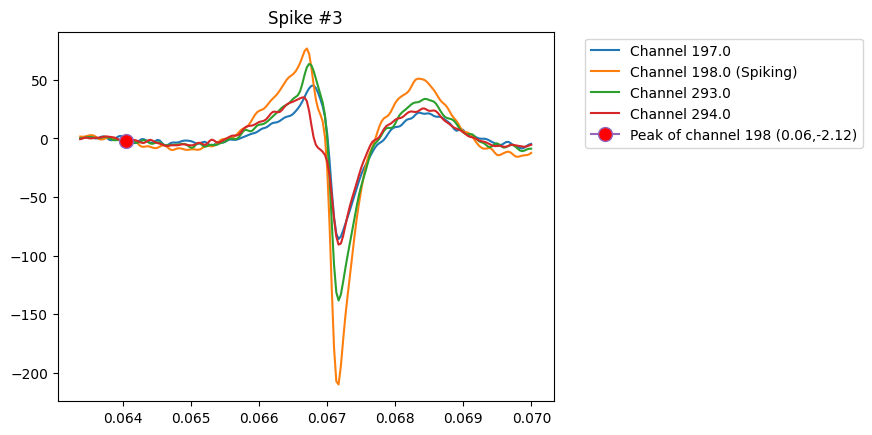

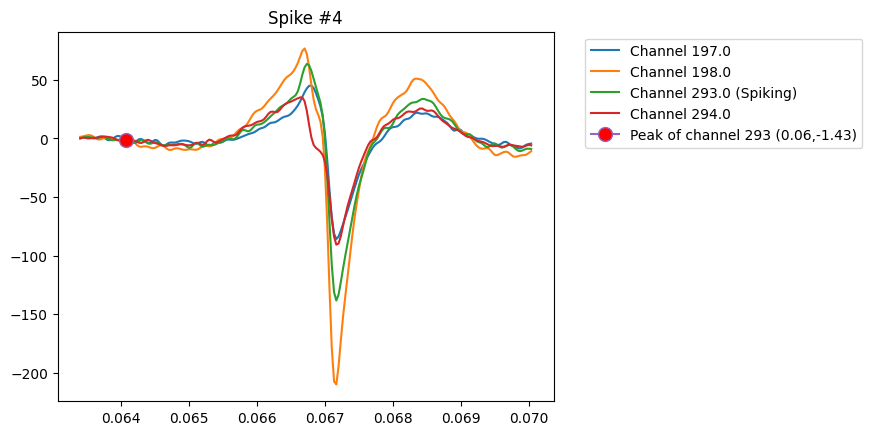

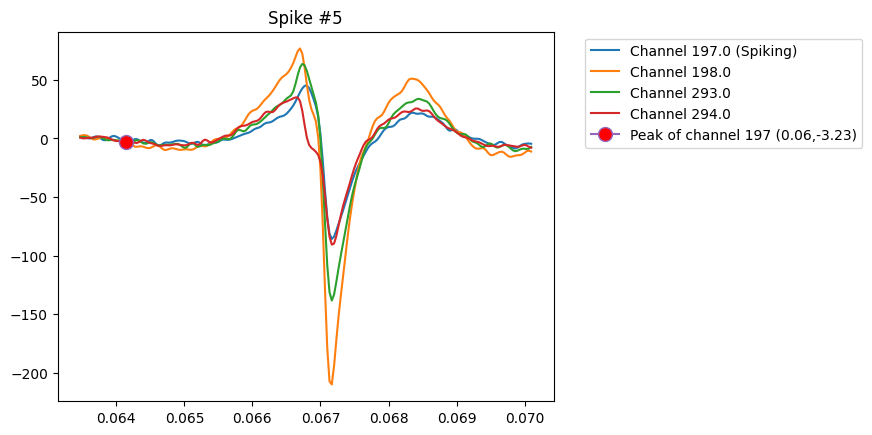

...

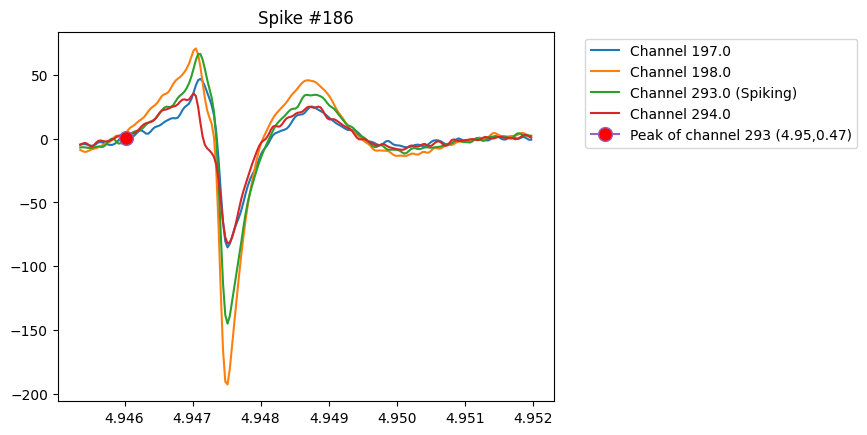

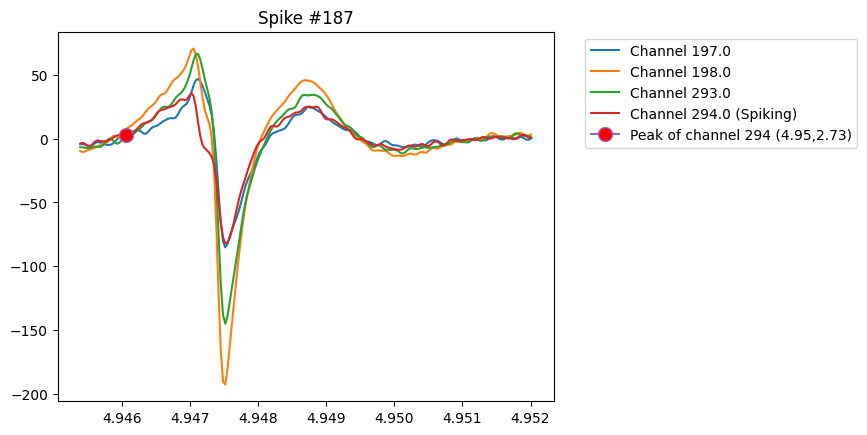

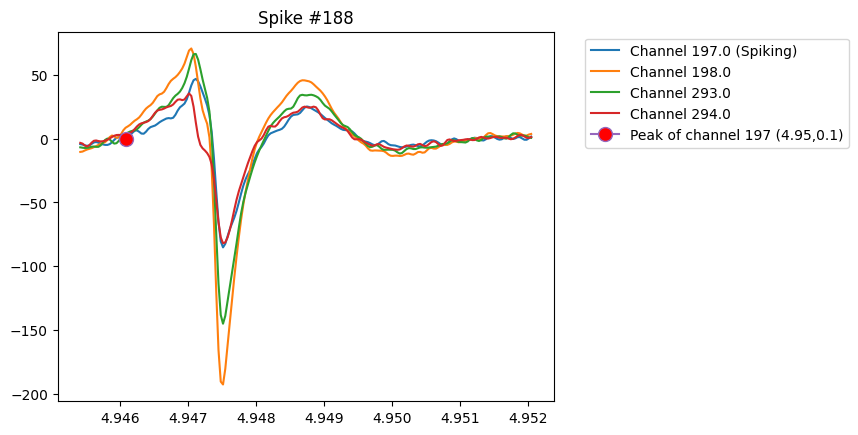

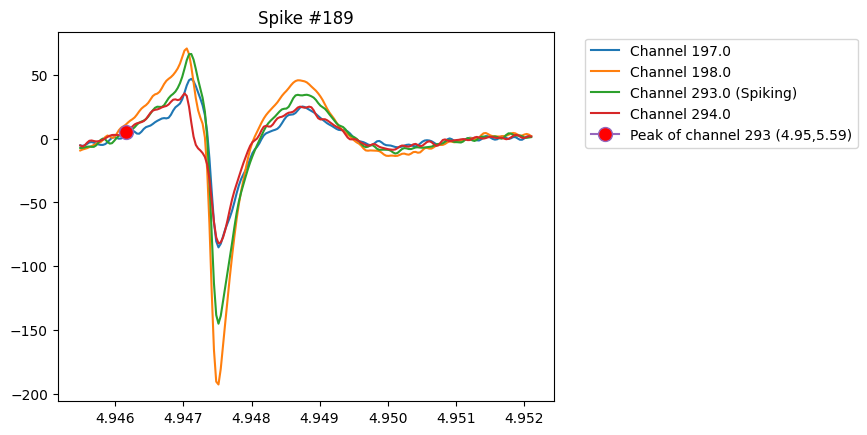

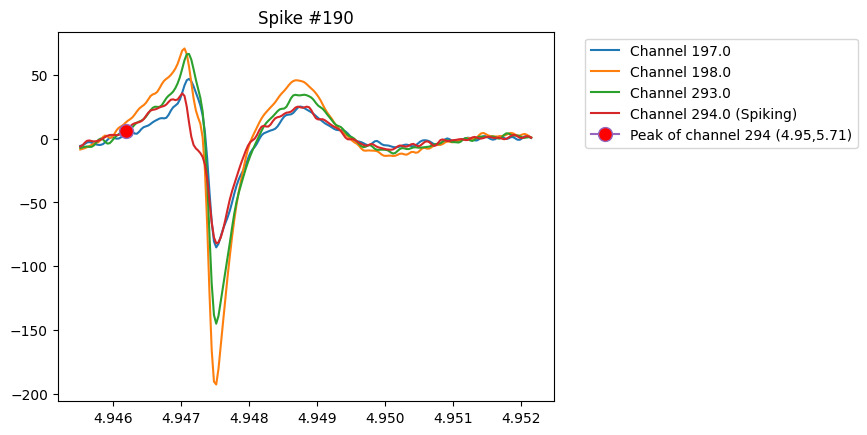

In [207]:
name_to_save_fig_under = "Channel  peaks.png"
save_dir = "Example of Spike Slices Channel 3";
plot_the_spikes_of_the_tetrode_ver_2(198,tetrode_dictionary,spike_tetrode_dictionary,timing_tetrode_dictionary,channel_to_tetrode_dictionary,spiking_channel_tetrode_dictionary,name_to_save_fig_under,save_dir)

[Errno 17] File exists: '/home/mint/Desktop/Ver 3 Spike 198 Ver 3'


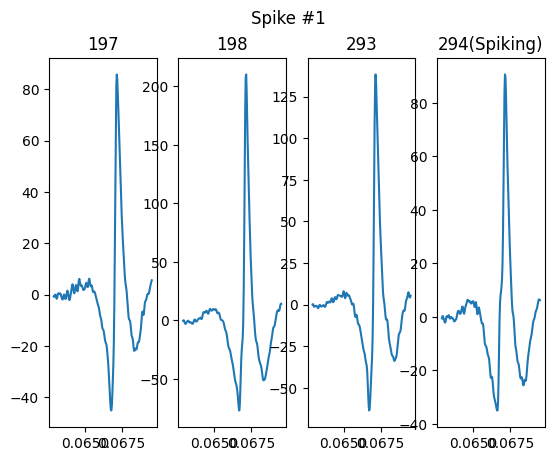

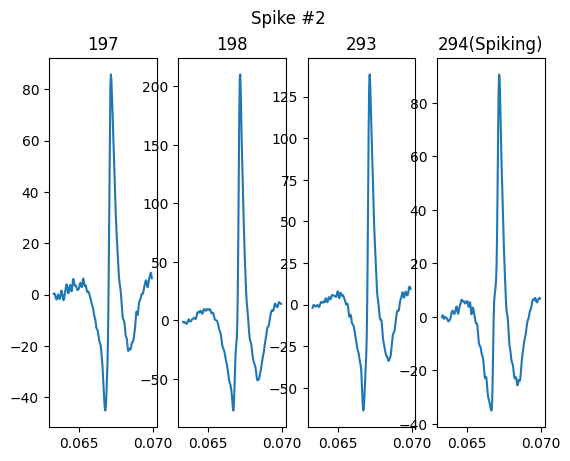

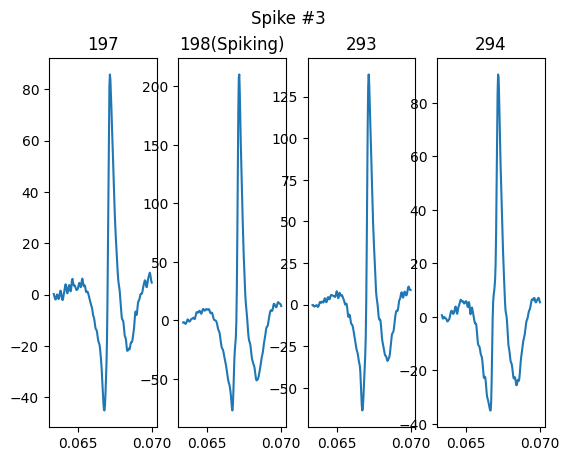

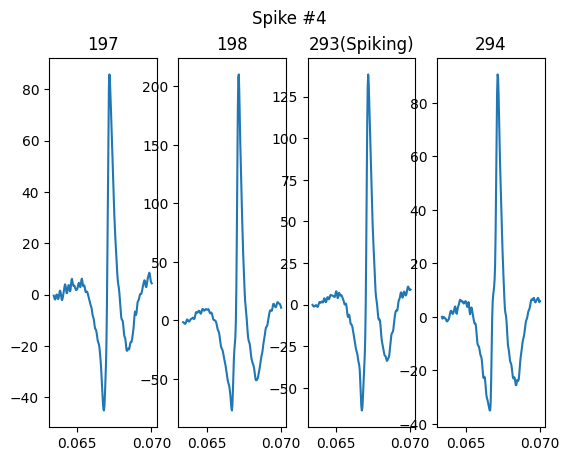

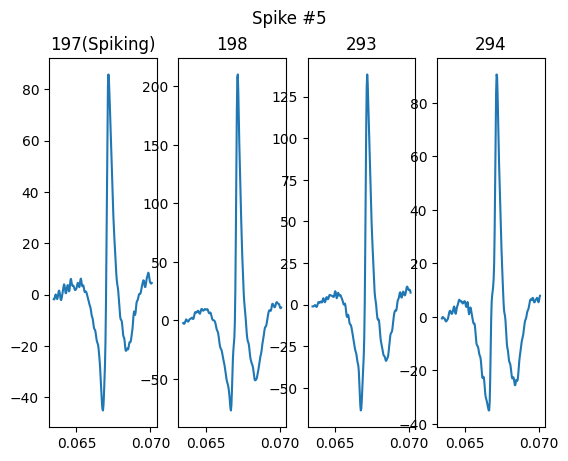

...

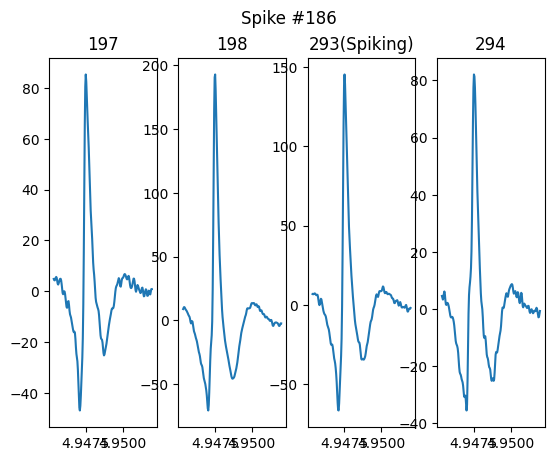

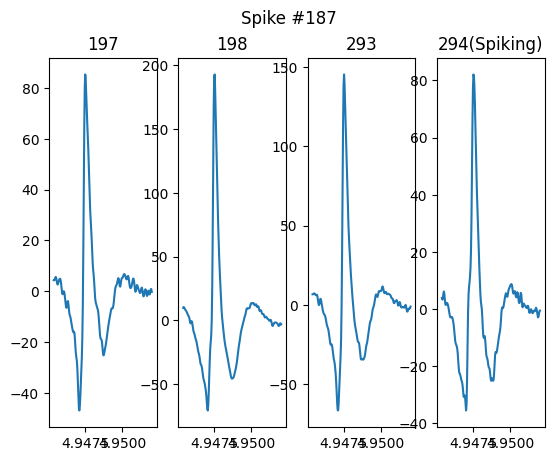

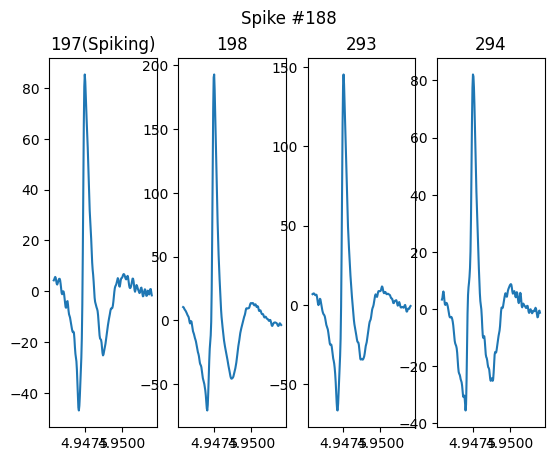

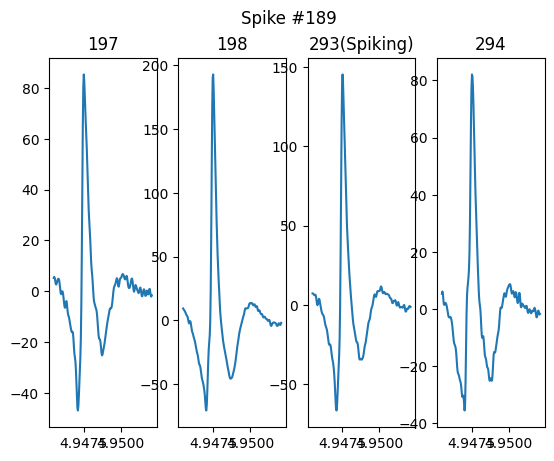

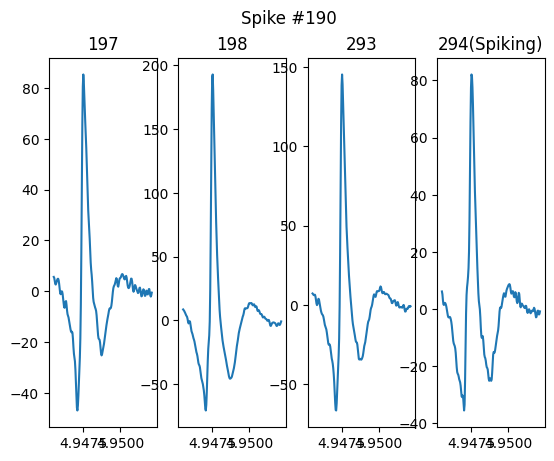

In [208]:
name_to_save_fig_under = ".png"
save_dir = "Ver 3 Spike 198 Ver 3";
plot_the_spikes_of_the_tetrode_ver_3(198,tetrode_dictionary,spike_tetrode_dictionary,timing_tetrode_dictionary,channel_to_tetrode_dictionary,spiking_channel_tetrode_dictionary,name_to_save_fig_under,save_dir,100)
